# Tugas Analisis Multimedia: Audio, Gambar, Video

**Mata Kuliah:** Sistem & Teknologi Multimedia  
**Nama:** Rayhan Fatih Gunawan  
**NIM:** 122140134 

---

## Deskripsi Tugas

Tugas ini bertujuan untuk memahami representasi dasar data multimedia (audio, gambar, dan video) melalui praktik langsung memuat data, visualisasi, dan ekstraksi informasi fundamental. Anda akan bekerja dengan tiga jenis media berbeda untuk menganalisis karakteristik temporal (audio), spasial (gambar), dan spatio-temporal (video).

Fokus tugas adalah pada pemahaman konsep dasar representasi multimedia dan kemampuan interpretasi hasil visualisasi, **bukan** pada manipulasi atau transformasi lanjutan data multimedia.

---

## ⚠️ CATATAN PENTING: PRESENTASI ACAK & KEJUJURAN AKADEMIK

**Sebagian mahasiswa akan dipilih secara ACAK untuk presentasi singkat** (5-10 menit) menjelaskan kode dan interpretasi hasil mereka. Jika Anda:
- Tidak mampu menjelaskan kode yang Anda kumpulkan
- Hanya menyalin-tempel tanpa pemahaman
- Bergantung sepenuhnya pada AI tanpa memahami konsep

**Maka nilai tugas Anda akan diberikan 0 (nol).**

Gunakan referensi dan AI sebagai alat bantu pembelajaran, tetapi pastikan Anda memahami setiap baris kode dan dapat menjelaskan logika di baliknya.

In [11]:
# Import Library (Satu-satunya sel kode dalam template ini)
import numpy as np
import matplotlib.pyplot as plt
import librosa
import soundfile as sf
from PIL import Image
import cv2
from IPython.display import Audio, HTML, display
import os

# Set matplotlib untuk menampilkan plot inline
%matplotlib inline

# Tampilkan versi library untuk dokumentasi
print("Library versions:")
print(f"NumPy: {np.__version__}")
print(f"Matplotlib: {matplotlib.__version__}")
print(f"Librosa: {librosa.__version__}")
print(f"OpenCV: {cv2.__version__}")

# Tambahkan import lain jika diperlukan saat mengerjakan tugas

Library versions:
NumPy: 2.2.6
Matplotlib: 3.10.6
Librosa: 0.11.0
OpenCV: 4.12.0


## Petunjuk Umum Pengerjaan

### 📋 Cara Menggunakan Template
- Gunakan notebook ini sebagai kerangka kerja utama
- Tulis penjelasan (markdown) **SEBELUM** menaruh kode agar maksud dan tujuan jelas
- Tambahkan sel kode di tempat yang sudah disediakan (tandai dengan TODO)
- Semua plot/gambar harus diberi judul, label sumbu, dan keterangan singkat

### 📊 Standar Visualisasi
- Setiap plot harus memiliki judul yang deskriptif
- Label sumbu X dan Y harus jelas
- Gunakan colorbar untuk plot yang memerlukan skala warna
- Berikan interpretasi singkat setelah setiap visualisasi

### 📂 Struktur Data yang Direkomendasikan
- Buat folder `data/` di direktori yang sama dengan notebook
- Gunakan nama file yang deskriptif (contoh: `audio_musik_piano.wav`, `gambar_pemandangan_gunung.jpg`)
- Dokumentasikan sumber data jika menggunakan dataset publik

### ⚠️ Larangan
- **Jangan** menaruh seluruh pekerjaan dalam satu sel kode yang sangat panjang
- **Jangan** menempel hasil output tanpa interpretasi atau analisis
- **Jangan** bergantung sepenuhnya pada AI - pahami dan kuasai kode Anda

### 🎯 Persiapan Presentasi Acak
- Pastikan Anda memahami setiap baris kode yang ditulis
- Latih menjelaskan logika dan alur pemikiran Anda
- Siapkan penjelasan untuk setiap visualisasi dan interpretasinya

## Checklist Kelengkapan (Centang ✅ saat selesai)

### 🎵 Bagian Audio
- [ ] Muat audio dan tampilkan metadata (durasi, sample rate, jumlah kanal)
- [ ] Tampilkan waveform dengan label sumbu yang jelas
- [ ] Tampilkan spectrogram dalam skala log-dB dengan colorbar
- [ ] Tampilkan MFCC (minimal 13 koefisien) sebagai heatmap
- [ ] Berikan interpretasi dan analisis untuk setiap visualisasi audio

### 🖼️ Bagian Gambar
- [ ] Tampilkan gambar dengan benar dalam format RGB
- [ ] Tampilkan informasi dasar (dimensi, jumlah kanal, dtype)
- [ ] Tampilkan histogram warna untuk channel R, G, B
- [ ] Berikan analisis hubungan histogram dengan kesan visual gambar

### 📹 Bagian Video
- [ ] Tampilkan metadata video (resolusi, fps, frame count, durasi)
- [ ] Tampilkan 3 frame representatif (awal, tengah, akhir)
- [ ] Konversi BGR ke RGB dengan benar untuk visualisasi
- [ ] Analisis kesesuaian parameter video dengan use case

### 📝 Analisis & Dokumentasi
- [ ] Setiap bagian memiliki interpretasi dan analisis ringkas
- [ ] Perbandingan representasi ketiga jenis media
- [ ] Kesimpulan pembelajaran dan refleksi
- [ ] Semua sumber data dan referensi dicantumkan

# Pendahuluan

## Apa itu Data Multimedia?

Data multimedia adalah informasi yang dikodekan dalam berbagai format untuk merepresentasikan dunia nyata:

- **Audio (1D)**: Sinyal satu dimensi yang berubah terhadap waktu
  - Contoh: musik, suara, speech
  - Representasi: amplitudo vs waktu
  
- **Gambar (2D)**: Matriks nilai intensitas dalam ruang dua dimensi
  - Contoh: foto, ilustrasi, grafik
  - Representasi: intensitas pixel pada koordinat (x,y)
  
- **Video (2D + Waktu)**: Rangkaian frame (gambar) yang ditampilkan berurutan
  - Contoh: film, rekaman, animasi
  - Representasi: frame berubah terhadap waktu dengan frame rate tertentu

## Tujuan Tugas

Memahami representasi dasar dan teknik visualisasi fundamental untuk setiap jenis media multimedia, termasuk:
- Cara memuat dan membaca file multimedia
- Ekstraksi informasi metadata yang penting
- Visualisasi yang informatif dan mudah dipahami
- Interpretasi hasil analisis secara kontekstual

## Cara Kerja

1. Isi setiap bagian sesuai instruksi yang diberikan
2. Tambahkan sel kode di tempat yang ditandai dengan "TODO"
3. Berikan interpretasi dan analisis setelah setiap visualisasi
4. Pastikan semua plot memiliki judul, label, dan keterangan yang jelas

# Bagian A — Audio

### A1. Deskripsi Data

**TODO:** Jelaskan audio yang akan Anda analisis:
- Jenis audio: musik (hyperpop) (musik, pidato, suara alam, dll.)
- Sumber: Bladee, source : trash island (rekaman sendiri, dataset publik, dll.)
- Format file: MP3 (WAV, MP3, dll.)
- Alasan pemilihan: Lagu favorit, dari musisi favorit, dan genre favorit

**Path file:** `data/_____.wav` (isi nama file Anda nanti di kode)

---





### A2. TODO: Muat & Metadata

**Instruksi:**
Tulis kode untuk memuat file audio dan menampilkan metadata dasar:
- Sample rate (Hz)
- Durasi (detik)
- Jumlah kanal (mono/stereo)
- Jumlah total sampel

**Catatan:** Jika file MP3 bermasalah saat loading, gunakan format WAV sebagai alternatif.





Memuat library untuk audio processing dan memuat file (musik) di variabel PATH_AUDIO untuk menampilkan Metadata

In [61]:
import librosa
import soundfile as sf
import numpy as np
import scipy
import matplotlib.pyplot as plt
from IPython.display import Audio
import os


PATH_AUDIO = os.path.join(os.getcwd(), 'data', 'Waster.mp3')

y = None
sr = None
source_info = ""

y, sr = librosa.load(PATH_AUDIO, sr=None)  
source_info = f"Berhasil memuat: {PATH_AUDIO}"
   


# Pastikan tipe data float32 untuk efisiensi
y = y.astype(np.float32)

print(source_info)
print(f"📊 Shape data: {y.shape}")
print(f"🎵 Sample rate: {sr} Hz")
print(f"jumlah kanal: {y.ndim}")

Berhasil memuat: c:\Users\HP\Downloads\MULMED_2\IF25-40305-handson\data\Waster.mp3
📊 Shape data: (5841441,)
🎵 Sample rate: 48000 Hz
jumlah kanal: 1


In [76]:
# Memutar Audio di Notebook
print("🔊 Audio Player - Pastikan volume tidak terlalu keras!")
print(f"🎵 Durasi: {len(y)/sr:.2f} detik")
print(f"📻 Sample rate: {sr} Hz")
print("▶️ Klik tombol play di bawah untuk mendengar audio:")

# Tampilkan audio player
Audio(y, rate=sr)

🔊 Audio Player - Pastikan volume tidak terlalu keras!
🎵 Durasi: 121.70 detik
📻 Sample rate: 48000 Hz
▶️ Klik tombol play di bawah untuk mendengar audio:


---

### A3. TODO: Waveform

**Instruksi:**
Plot waveform audio dengan:
- Sumbu X: waktu (detik)
- Sumbu Y: amplitudo
- Judul dan label sumbu yang jelas

**Analisis yang diperlukan:**
Jelaskan apa yang Anda lihat dari waveform (pola amplitudo, bagian keras/pelan, dll.)



Membuat 2 plot waveform dan zoomed waveform

C:\Users\HP\AppData\Local\Temp\ipykernel_17528\2772436794.py:40: UserWarning: Glyph 127925 (\N{MUSICAL NOTE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\HP\AppData\Local\Temp\ipykernel_17528\2772436794.py:40: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()


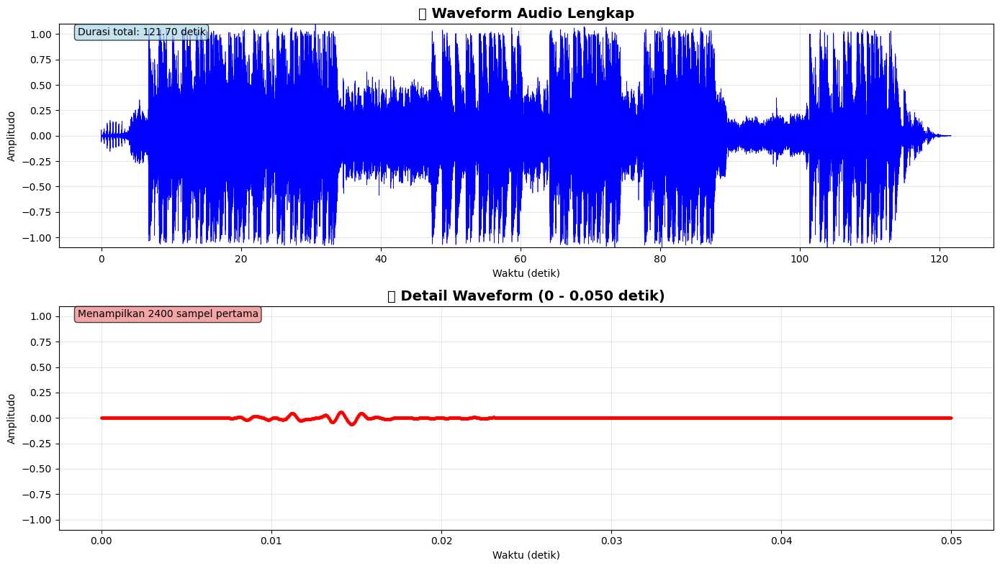

✅ Waveform berhasil ditampilkan!
📊 Total sampel yang diplot: 5,841,441
🔍 Sampel zoom detail: 2400


In [62]:
# Plot Waveform dengan Detail Zoom
# Buat vektor waktu
t = np.linspace(0, len(y)/sr, len(y))

# Setup plot dengan 2 subplot
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 8))

# Plot 1: Waveform lengkap
ax1.plot(t, y, color='blue', linewidth=0.5)
ax1.set_title('🎵 Waveform Audio Lengkap', fontsize=14, fontweight='bold')
ax1.set_xlabel('Waktu (detik)')
ax1.set_ylabel('Amplitudo')
ax1.grid(True, alpha=0.3)
ax1.set_ylim([-1.1, 1.1])

# Tambahkan informasi durasi
duration_text = f'Durasi total: {len(y)/sr:.2f} detik'
ax1.text(0.02, 0.95, duration_text, transform=ax1.transAxes, 
         bbox=dict(boxstyle="round,pad=0.3", facecolor="lightblue", alpha=0.7))


# Plot 2: Zoom detail 0-0.05 detik (atau maksimal 10% dari durasi total)
zoom_duration = min(0.05, (len(y)/sr) * 0.1)
zoom_samples = int(zoom_duration * sr)
t_zoom = t[:zoom_samples]
y_zoom = y[:zoom_samples]

ax2.plot(t_zoom, y_zoom, color='red', linewidth=1.5, marker='o', markersize=2)
ax2.set_title(f'🔍 Detail Waveform (0 - {zoom_duration:.3f} detik)', fontsize=14, fontweight='bold')
ax2.set_xlabel('Waktu (detik)')
ax2.set_ylabel('Amplitudo')
ax2.grid(True, alpha=0.3)
ax2.set_ylim([-1.1, 1.1])

# Tambahkan informasi zoom
zoom_text = f'Menampilkan {zoom_samples} sampel pertama'
ax2.text(0.02, 0.95, zoom_text, transform=ax2.transAxes,
         bbox=dict(boxstyle="round,pad=0.3", facecolor="lightcoral", alpha=0.7))

plt.tight_layout()
plt.show()

print(f"✅ Waveform berhasil ditampilkan!")
print(f"📊 Total sampel yang diplot: {len(y):,}")
print(f"🔍 Sampel zoom detail: {zoom_samples}")

*ANALISIS*

Sebuah musik hyperpop memiliki sebaran suara yang luas pada frekuensi tetapi cenderung memiliki suara bass (808) yang cukup kuat. Suara bass merupakan suara yang lebih tedengar dibandingkan frekuansi lainnya.

Pada Waveform audio lengkap terlihat dimana beat terdapat bass (808) atau tidak misalnya detik 5 sampai dengan 35 dan detik selanjutnya amplitudo menurun menandakan bass tidak ada. Tetapi juga bisa menandakan frekuensi lain turun juga intensitasnya. Pada grafik wavefrom tidak bisa diamati.

---

### A4. TODO: Spectrogram log-dB

**Instruksi:**
Hitung STFT dan tampilkan spectrogram dalam skala log-dB:
- Gunakan parameter standar (n_fft=1024, hop_length=256)
- Tampilkan dengan colorbar
- Label sumbu: waktu (detik) dan frekuensi (Hz)

**Analisis yang diperlukan:**
Jelaskan perbedaan informasi yang didapat dari spectrogram dibanding waveform.



Membuat magnitude spectogram(Log dB), kalkulasi STFT dan tampilkan keduanya

C:\Users\HP\AppData\Local\Temp\ipykernel_17528\2132450356.py:26: UserWarning: Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
c:\Users\HP\Downloads\MULMED_2\IF25-40305-handson\.venv\lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


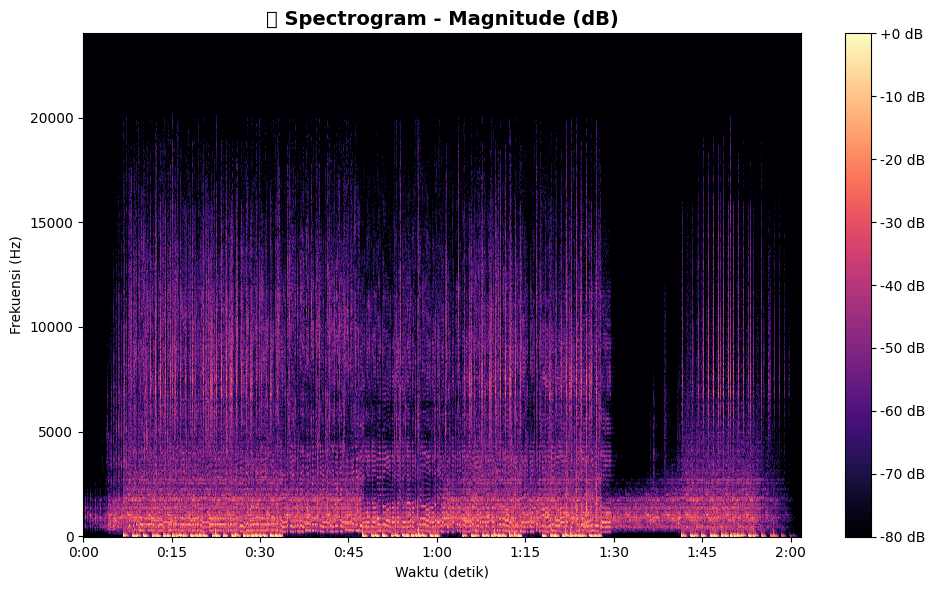

📋 INFORMASI STFT
🔢 Ukuran FFT: 1024
👣 Hop length: 256
🪟 Window function: hann
📊 Shape magnitude: (513, 22819)
⏱️ Resolusi waktu: 5.3 ms per frame
🎵 Resolusi frekuensi: 46.9 Hz per bin
📈 Range magnitude (dB): -80.0 - 0.0


In [86]:
# Hitung dan Plot Spectrogram (STFT)
# Parameter STFT
n_fft = 1024        # Ukuran FFT window
hop_length = 256    # Langkah antar frame
window = 'hann'     # Jenis window function

# Hitung STFT
D = librosa.stft(y, n_fft=n_fft, hop_length=hop_length, window=window)
magnitude = np.abs(D)
magnitude_db = librosa.amplitude_to_db(magnitude, ref=np.max)

# Setup plot dengan 1 plot
plt.figure(figsize=(10, 6))
ax = plt.gca() 



# Magnitude Spectrogram (Log dB)
img= librosa.display.specshow(magnitude_db, x_axis='time', y_axis='hz',
                               sr=sr, hop_length=hop_length, ax=ax)
ax.set_title('📊 Spectrogram - Magnitude (dB)', fontsize=14, fontweight='bold')  
ax.set_xlabel('Waktu (detik)')
ax.set_ylabel('Frekuensi (Hz)')
plt.colorbar(img, ax=ax, format='%+2.0f dB')

plt.tight_layout()
plt.show()

# Informasi STFT
print("📋 INFORMASI STFT")
print("=" * 40)
print(f"🔢 Ukuran FFT: {n_fft}")
print(f"👣 Hop length: {hop_length}")
print(f"🪟 Window function: {window}")
print(f"📊 Shape magnitude: {magnitude.shape}")
print(f"⏱️ Resolusi waktu: {hop_length/sr*1000:.1f} ms per frame")
print(f"🎵 Resolusi frekuensi: {sr/n_fft:.1f} Hz per bin")
print(f"📈 Range magnitude (dB): {magnitude_db.min():.1f} - {magnitude_db.max():.1f}")

*ANALISIS*

Pada spectorgram dapat terlihat secara jelas dibandingkan wavefrom perbedaan intensitas di sebaran frekuensinya. Dimana wavefrom hanya menampilkan amplitudo seiring waktu. Spectogram menampilan frekuensi dan intensitas (decible) seiring waku

Bisa diamati lebih jelas sebelumnya pada detik 5 sampai dengan 35 detik terdapat bass (808) bisa merupakan prechorus, lalu detik selanjutnya bass(808) tersebut menghilang, frekuensi tengah memiliki decible kurang lebih sama menandakan vokal dan synth mungkin sama seperti sebelumnya, pada frekuensi tinggi terdapat perbedaan yang menandakan menghilangnya hi-hats, snare, ataupun claps.

Spectogram lebih membantu untuk menampilkan bentuk audio secara visual dibandingkan waveform


---

### A5. TODO: MFCC

**Instruksi:**
Hitung dan tampilkan minimal 13 koefisien MFCC sebagai heatmap:
- Sumbu X: waktu (frame)
- Sumbu Y: koefisien MFCC (1-13)
- Gunakan colorbar dan judul yang jelas

**Analisis yang diperlukan:**
Interpretasi sederhana: apakah pola MFCC stabil atau berubah-ubah? Apa potensi maknanya?



Membuat MFCC dengan koefisien 13

C:\Users\HP\AppData\Local\Temp\ipykernel_17528\1233243062.py:24: UserWarning: Glyph 127919 (\N{DIRECT HIT}) missing from font(s) DejaVu Sans.
  plt.tight_layout()


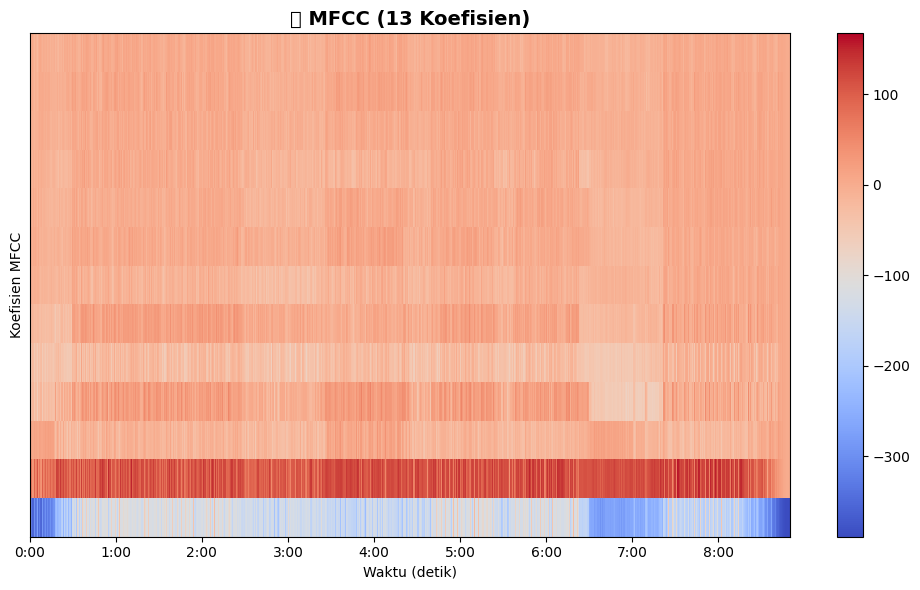

📋 INFORMASI MFCC
🎯 Jumlah MFCC: 13
📊 Shape MFCC: (13, 22819)
📈 Range MFCC: -388.92 - 167.09

✅ Semua fitur spektral berhasil dihitung!
🎵 Mel-spectrogram: Representasi frekuensi sesuai persepsi manusia
🎯 MFCC: Ringkasan spektral untuk machine learning


In [87]:
# Hitung Mel-Spectrogram dan MFCC
# Parameter untuk Mel-spectrogram
n_mels = 64  # Jumlah mel bins
fmax = sr // 2  # Frekuensi maksimum (Nyquist frequency)



# Hitung MFCC (13 koefisien)
n_mfcc = 13
mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=n_fft, 
                           hop_length=hop_length, n_mels=n_mels)

# Setup plot dengan 1 plot
plt.figure(figsize=(10, 6))
ax = plt.gca() 

# MFCC (Heatmap)
img = librosa.display.specshow(mfcc, x_axis='time', ax=ax)
ax.set_title('🎯 MFCC (13 Koefisien)', fontsize=14, fontweight='bold')
ax.set_xlabel('Waktu (detik)')
ax.set_ylabel('Koefisien MFCC')
plt.colorbar(img, ax=ax)

plt.tight_layout()
plt.show()

# Informasi Mel & MFCC
print("📋 INFORMASI MFCC")
print("=" * 50)
print(f"🎯 Jumlah MFCC: {n_mfcc}")
print(f"📊 Shape MFCC: {mfcc.shape}")
print(f"📈 Range MFCC: {mfcc.min():.2f} - {mfcc.max():.2f}")
print()
print("✅ Semua fitur spektral berhasil dihitung!")
print("🎵 Mel-spectrogram: Representasi frekuensi sesuai persepsi manusia")
print("🎯 MFCC: Ringkasan spektral untuk machine learning")

*ANALISIS*

Pola MFCC sebagain besar sangat stabil, tidak ada warna pucat ataupun gelap yang menandakan tidak ada suara putus putus dan terpata blok coklat tua dan biru  yang berjalan lurus dan konsisten

Potensi maknanya adalah audio ini bukan sebuah percakapan atau suara apapun yang terdapat jeda (seperti kicau burung buruh atau sepoi sepoi aingin) dan kemterdapat sinyal audio sintesis maka karena itu MFCC stabil

---









### A6. Analisis Ringkas (Wajib)

**Jawab pertanyaan berikut:**

1. **Perbedaan insight:** Apa perbedaan informasi yang didapat dari waveform versus spectrogram?

   *Jawaban Anda:* spectogram memberikan infromasi adanya suara yang deciblenya turun atau naik di sebaran frekuensi sehingga informasi bisa lebih banyak diambil daripada waveform yang menampilkan amplitudo seiring waktu

2. **Pembelajaran dari MFCC:** Apa yang Anda pelajari dari visualisasi MFCC audio ini?

   *Jawaban Anda:* Sinyal audio dari musik bergenre hyperpop memiliki MFCC yang cenderung stabil karena banyaknya sinyal audio sintesis dari VST (Virtual Synthizer)

In [64]:
# Memutar Audio di Notebook
print("🔊 Audio Player - Pastikan volume tidak terlalu keras!")
print(f"🎵 Durasi: {len(y)/sr:.2f} detik")
print(f"📻 Sample rate: {sr} Hz")
print("▶️ Klik tombol play di bawah untuk mendengar audio:")

# Tampilkan audio player
Audio(y, rate=sr)

🔊 Audio Player - Pastikan volume tidak terlalu keras!
🎵 Durasi: 121.70 detik
📻 Sample rate: 48000 Hz
▶️ Klik tombol play di bawah untuk mendengar audio:


# Bagian B — Gambar

### B1. Deskripsi Data

**TODO:** Jelaskan gambar yang akan Anda analisis:
- Jenis gambar: foto (foto, ilustrasi, pemandangan, dll.)
- Sumber: foto sendiri (pocket cam) (foto sendiri, dataset publik, dll.)
- Format file: JPG (JPG, PNG, BMP, dll.)
- Alasan pemilihan: Momen berkesan

**Path file:** `data/_____.jpg` (isi nama file Anda nanti di kode)

---

## B2. TODO: Baca & Tampilkan (RGB)

**Instruksi:**
Baca gambar dan tampilkan dengan benar dalam format RGB:
- Pastikan konversi warna benar (ingat perbedaan BGR vs RGB di OpenCV)
- Berikan judul yang deskriptif
- Hilangkan axis untuk tampilan yang bersih

**Analisis yang diperlukan:**
Jelaskan gambar secara ringkas (objek dominan, kondisi pencahayaan, komposisi warna).



Memuat library, memuat file gambar dan menampilkan ukuran, mode warna, dan format file gambar

In [67]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
import cv2
import numpy as np
import os

# Load Gambar dengan Sistem Fallback
PATH_IMAGE = os.path.join(os.getcwd(), 'data', 'digicam.jpg')  # Ganti dengan path gambar Anda

# Variabel untuk menyimpan hasil
img_pil = None
source_info = ""

# Opsi 1: Coba muat file lokal dengan PIL
img_pil = Image.open(PATH_IMAGE)
        # Pastikan dalam mode RGB (bukan RGBA atau mode lain)
if img_pil.mode != 'RGB':
    img_pil = img_pil.convert('RGB')
    source_info = f"✅ Berhasil memuat: {PATH_IMAGE}"

        

print(source_info)
print(f"📊 Ukuran gambar: {img_pil.size} (lebar x tinggi)")
print(f"🎨 Mode warna: {img_pil.mode}")
print(f"📁 Format: {img_pil.format if img_pil.format else 'Generated'}")


📊 Ukuran gambar: (2304, 1728) (lebar x tinggi)
🎨 Mode warna: RGB
📁 Format: JPEG


Menampilkan gambar dan informasi ukuran pixel dan mode warna dari gambar

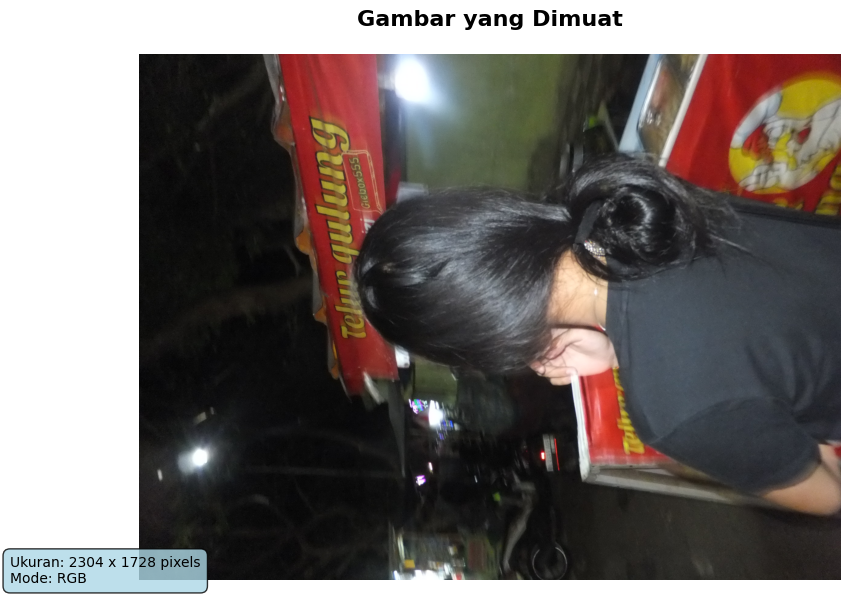

✅ Gambar berhasil ditampilkan!
📐 Resolusi: 2304 x 1728 pixels
🎨 Total pixel: 3,981,312


In [88]:
# Visualisasi Gambar dengan Matplotlib
plt.figure(figsize=(10, 6))

# Tampilkan gambar
plt.imshow(img_pil)
plt.title('Gambar yang Dimuat', fontsize=16, fontweight='bold', pad=20)

# Hilangkan axis untuk tampilan yang lebih bersih
plt.axis('off')

# Tambahkan informasi gambar sebagai text
info_text = f"Ukuran: {img_pil.size[0]} x {img_pil.size[1]} pixels\nMode: {img_pil.mode}"
plt.figtext(0.02, 0.02, info_text, fontsize=10, 
           bbox=dict(boxstyle="round,pad=0.5", facecolor="lightblue", alpha=0.8))

# Tampilkan dengan layout yang rapi
plt.tight_layout()
plt.show()

print("✅ Gambar berhasil ditampilkan!")
print(f"📐 Resolusi: {img_pil.size[0]} x {img_pil.size[1]} pixels")
print(f"🎨 Total pixel: {img_pil.size[0] * img_pil.size[1]:,}")

*ANALISIS*

Gambar ini memiliki objek dominan figur (orang), gambar ini ditake pada malam hari menggunakan flash dari jarak dekat, warga dominan adalah warna hitam

---

### B3. TODO: Informasi Dasar

**Instruksi:**
Tampilkan informasi metadata gambar:
- Dimensi (Height × Width)
- Jumlah kanal
- Tipe data (dtype)
- Mode warna (jika relevan)
- Ukuran file dalam memori

**Analisis yang diperlukan:**
Jelaskan mengapa informasi ini penting untuk tahap preprocessing atau analisis lanjutan.



Print informasi  Dimensi (Height × Width), Jumlah kanal, Tipe data (dtype), Mode warna (jika relevan), Ukuran file dalam memori dari gambar.


In [105]:
# Metadata Gambar - Informasi Lengkap
print("📋 METADATA GAMBAR")
print("=" * 50)


print(f"📐 Ukuran (W x H): {img_pil.size[0]} x {img_pil.size[1]} pixels")
print(f"🎨 Mode warna: {img_pil.mode}")

# Konversi ke numpy array untuk analisis lebih detail
img_array = np.array(img_pil)


print(f"📊 Shape (H, W, C): {img_array.shape}")
print(f"💾 Tipe data: {img_array.dtype}")
print(f"🗃️ Ukuran memori: {img_array.nbytes:,} bytes ({img_array.nbytes/1024:.1f} KB)")



# Informasi channel
if len(img_array.shape) == 3:
    height, width, channels = img_array.shape
    print(f"📏 Dimensi: {height} (tinggi) x {width} (lebar) x {channels} (channel)")
    if channels == 3:
        print("🎨 Channel: Red, Green, Blue (RGB)")
        # Statistik per channel
        for i, color in enumerate(['Red', 'Green', 'Blue']):
            channel_mean = np.mean(img_array[:, :, i])
            print(f"   {color}: rata-rata = {channel_mean:.1f}")
    elif channels == 1:
        print("⚫ Channel: Grayscale")
else:
    print(f"\n⚫ GRAYSCALE IMAGE:")
    print(f"📏 Dimensi: {img_array.shape[0]} x {img_array.shape[1]}")



📋 METADATA GAMBAR
📐 Ukuran (W x H): 2304 x 1728 pixels
🎨 Mode warna: RGB
📊 Shape (H, W, C): (1728, 2304, 3)
💾 Tipe data: uint8
🗃️ Ukuran memori: 11,943,936 bytes (11664.0 KB)
📏 Dimensi: 1728 (tinggi) x 2304 (lebar) x 3 (channel)
🎨 Channel: Red, Green, Blue (RGB)
   Red: rata-rata = 66.9
   Green: rata-rata = 56.9
   Blue: rata-rata = 53.1


*ANALISIS*

Informasi ini penting untuk proses lanjutan. Misalnya, untuk input model CNN yang memerlukan input yang seragam (dimensi & kanal) untuk layernya. Ukuran memori penting untuk mengukur sumber daya yang digunakan untuk computer vision

---

### B4. TODO: Histogram Warna

**Instruksi:**
Tampilkan histogram distribusi intensitas untuk channel R, G, B:
- Range: 0-255
- Plot terpisah atau overlay dengan warna sesuai channel
- Label sumbu: intensitas pixel dan frekuensi
- Legend yang jelas

**Analisis yang diperlukan:**
Analisis: channel mana yang dominan? Bagaimana kontras gambar? Seperti apa sebaran intensitasnya?



Membuat legenda histogram dengan 3 channel (RGB) dengan range 225

In [74]:
img1 = cv2.imread(PATH_IMAGE)
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)

histo_red = cv2.calcHist([img1], [0], None, [255], [0, 255])
histo_green = cv2.calcHist([img1], [1], None, [255], [0, 255])
histo_blue = cv2.calcHist([img1], [2], None, [255], [0, 255])

Membuat plot histogram dengan legenda histogram diatas, plot overlay

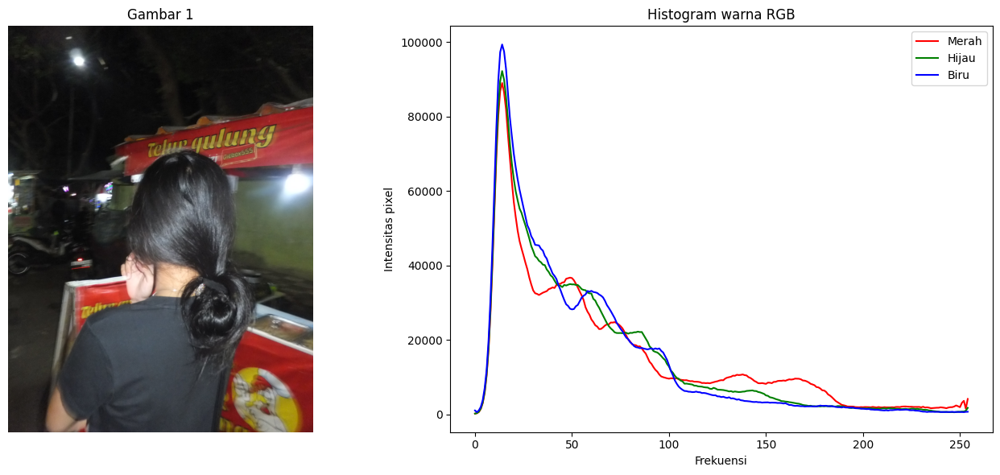

In [75]:
fig, ax = plt.subplots(1, 2, figsize=(14, 6))

# Plot the actual image
ax[0].imshow(img1)
ax[0].set_title('Gambar 1')
ax[0].axis('off')

# Plot the histogram
ax[1].plot(histo_red, color='red')
ax[1].plot(histo_green, color='green')
ax[1].plot(histo_blue, color='blue')
ax[1].set_title('Histogram warna RGB')
ax[1].set_xlabel('Frekuensi')
ax[1].set_ylabel('Intensitas pixel')
ax[1].legend(['Merah', 'Hijau', 'Biru'])

plt.tight_layout()
plt.show()

*ANALISIS*

Pada gambar ini kanal paling dominan adalah warna merah meskipun warna gelap yang membuat warna biru memuncak, warna merah secara konsisten memiliki jumlah piksel lebih tinggi.

Gambar ini juga memiliki kontras tinggi, terdapat spike di intensitas warna yang rendah dan yang tinggi. Untuk intensitas warna di gambar ini cenderung rendah karena  intensitas pixel di frekuensi yang rendah sangat tinggi.


---









### B5. Analisis Ringkas (Wajib)

**Jawab pertanyaan berikut:**

**Relasi histogram dengan kesan visual:** Apa hubungan antara pola histogram yang Anda lihat dengan kesan visual gambar (terang/gelap, warna dominan, kontras)?

*Jawaban Anda:* Histogram mempresentasikan gambar dengan baik, saya bisa melihat adanya spike di frekuensi rendah menandakan banyak pixel yang berwarna gelap yang dimana gambar itu diambil pada malam hari. Terdapat spike lagi di frekuensi tinggi di semua kanal karena di gambar ada bohlam dari gerobak pinggir jalan, kanal meraha konsisten memiliki pixel di sepanjang frekuensi karena ada gerobak warna merah.

# Bagian C — Video

### C1. Deskripsi Data

**TODO:** Jelaskan video yang akan Anda analisis:
- Jenis video: aktivitas (aktivitas, pemandangan, tutorial, dll.)
- Sumber: rekaman sendiri (cam corder) (rekaman sendiri, dataset publik, dll.)
- Durasi target: 30 detik (disarankan ≤ 30 detik untuk efisiensi)
- Alasan pemilihan: Karena menggunakan camcorder yang saya pinjam dari teman saya

**Path file:** `data/_____.mp4` (isi nama file Anda nanti di kode)

---

### C2. TODO: Baca & Metadata

**Instruksi:**
Baca video dengan OpenCV dan tampilkan metadata:
- Resolusi (Width × Height)
- Frame rate (fps)
- Jumlah total frame
- Durasi (detik)
- Klasifikasi resolusi (HD, Full HD, 4K, dll.)

**Analisis yang diperlukan:**
Jelaskan pentingnya parameter-parameter tersebut untuk analisis video atau aplikasi tertentu.



Memuat library untuk video processing, karena sebelumnya beberapa sudah dimuat untuk image processing, cell code ini hanya memastikan apakah semua library sudah dimuat

In [114]:

print("📹 Setup Video Processing")
print("=" * 40)

# Pastikan semua library sudah tersedia
try:
    import cv2
    import matplotlib.pyplot as plt
    import numpy as np
    import os
    print("✅ OpenCV tersedia")
    print("✅ Matplotlib tersedia") 
    print("✅ NumPy tersedia")
except ImportError as e:
    print(f"❌ Error import: {e}")
    print("Jalankan: !pip install opencv-python matplotlib numpy")

# Tampilkan versi pustaka untuk video processing
print("\n📋 Versi pustaka untuk video:")
print(f"OpenCV: {cv2.__version__}")
print(f"Matplotlib: {plt.matplotlib.__version__}")
print(f"NumPy: {np.__version__}")
print("\n✅ Setup video processing selesai!")

📹 Setup Video Processing
✅ OpenCV tersedia
✅ Matplotlib tersedia
✅ NumPy tersedia

📋 Versi pustaka untuk video:
OpenCV: 4.12.0
Matplotlib: 3.10.6
NumPy: 2.2.6

✅ Setup video processing selesai!


Memuat video menggunakan cv2

In [115]:
# Load Video dengan Error Handling
PATH_VIDEO = os.path.join(os.getcwd(), 'data', 'gigs.mp4')  # Ganti dengan path video Anda

print("📹 Mencoba membaca video...")
print(f"🎯 Target file: {PATH_VIDEO}")

# Buat objek VideoCapture
cap = cv2.VideoCapture(PATH_VIDEO)

# Periksa apakah video berhasil dibuka meng
if cap.isOpened():
    print("✅ Video berhasil dibuka!")
    source_info = f"✅ Berhasil memuat: {PATH_VIDEO}"
    video_loaded = True
else:
    print(f"❌ Gagal membuka video: {PATH_VIDEO}")
    
    # Cek apakah file ada
    if not os.path.exists(PATH_VIDEO):
        print(f"📁 File tidak ditemukan: {PATH_VIDEO}")
        print("\n💡 Tips:")
        print("1. Pastikan file video ada di folder 'data/'")
        print("2. Coba format MP4, AVI, atau MOV")
        print("3. Periksa nama file dan ekstensi")
    else:
        print(f"📁 File ditemukan tapi tidak bisa dibaca")
        print("💡 Kemungkinan format tidak didukung atau file rusak")
    
    source_info = f"❌ Gagal memuat: {PATH_VIDEO}"
    video_loaded = False
    
    # Bersihkan resource
    cap.release()

print(f"\n📊 Status: {source_info}")
print(f"🎬 Video loaded: {video_loaded}")

if not video_loaded:
    print("\n⚠️ PERHATIAN:")
    print("Video tidak dapat dimuat. Bagian selanjutnya akan menampilkan error.")
    print("Silakan ganti PATH_VIDEO dengan file video yang valid.")

📹 Mencoba membaca video...
🎯 Target file: c:\Users\HP\Downloads\MULMED_2\IF25-40305-handson\data\gigs.mp4
✅ Video berhasil dibuka!

📊 Status: ✅ Berhasil memuat: c:\Users\HP\Downloads\MULMED_2\IF25-40305-handson\data\gigs.mp4
🎬 Video loaded: True


Menampilkan metadata dari video

In [117]:
# Metadata Video - Ekstraksi Informasi Lengkap
if video_loaded:
    print("📋 METADATA VIDEO")
    print("=" * 50)
    
    # Ambil informasi dasar dari video
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)
    frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    
    # Hitung durasi (detik)
    duration = frame_count / fps if fps > 0 else 0
    
    print("📐 RESOLUSI & DIMENSI:")
    print(f"🖼️ Lebar: {width} pixels")
    print(f"🖼️ Tinggi: {height} pixels")
    print(f"📊 Resolusi: {width} × {height}")
   
    
    # Klasifikasi resolusi
    if height >= 2160:
        res_class = "4K Ultra HD"
    elif height >= 1080:
        res_class = "Full HD (1080p)"
    elif height >= 720:
        res_class = "HD (720p)"
    else:
        res_class = "Standard Definition"
    print(f"🏷️ Klasifikasi: {res_class}")
    print(f"🎬 Frame rate: {fps:.2f} fps")
    print(f"🔢 Total frame: {frame_count:,}")
    print(f"⏰ Durasi: {duration:.2f} detik ({duration/60:.1f} menit)")
    
    
    
   
    
    # Simpan informasi untuk digunakan nanti
    video_info = {
        'width': width,
        'height': height, 
        'fps': fps,
        'frame_count': frame_count,
        'duration': duration
    }
    
else:
    print("❌ Video tidak dimuat - tidak dapat mengekstrak metadata")
    print("Pastikan PATH_VIDEO menuju ke file video yang valid")

📋 METADATA VIDEO
📐 RESOLUSI & DIMENSI:
🖼️ Lebar: 640 pixels
🖼️ Tinggi: 480 pixels
📊 Resolusi: 640 × 480
🏷️ Klasifikasi: Standard Definition
🎬 Frame rate: 25.00 fps
🔢 Total frame: 802
⏰ Durasi: 32.08 detik (0.5 menit)


*ANALISIS*

Metadata ini penting untuk melanjutkan ke proses computer vision berikutnya, resolusi dapat mempengaruhi sumber daya komputer untuk pemrosesan tetapi dengan lebih banyak pixel lebih baik untuk train model, frame rate tinggi juga bisa memberikan lebih banyak sample yang bisa mengurangi kehilangan informasi



---

### C3. TODO: Tampilkan 3 Frame (Awal–Tengah–Akhir)

**Instruksi:**
Ambil dan tampilkan 3 frame representatif:
- Frame pertama (index 0)
- Frame tengah (index ~total_frame/2)
- Frame terakhir (index total_frame-1)
- **Konversi BGR→RGB** sebelum ditampilkan
- Subplot dengan judul frame dan timestamp

**Analisis yang diperlukan:**
Deskripsikan perbedaan visual antar frame dan apa yang dapat dipelajari dari sampel frame ini.



---

Menampilkan frame awal , tengah dan akhir, setup plot dengan tiga subplot, mengubah BGR menjadi RGB, lalu menampilkan plot dengan frame dan timestamp

📹 Mengekstrak dan menampilkan frame...


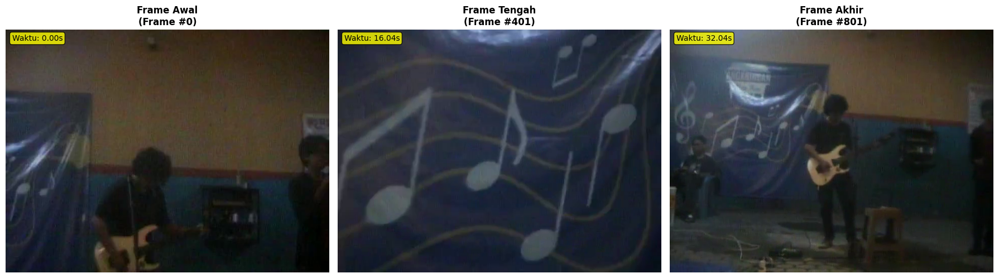

✅ Frame berhasil diekstrak!
📊 Resolusi frame: 640 × 480
🎯 Frame yang diekstrak:
   Frame Awal: Frame #0 (waktu 0.00s)
   Frame Tengah: Frame #401 (waktu 16.04s)
   Frame Akhir: Frame #801 (waktu 32.04s)

💡 Total frame berhasil diekstrak: 3
🔄 Video capture resource dibersihkan


In [111]:
# Visualisasi Frame dari Video
if video_loaded:
    print("📹 Mengekstrak dan menampilkan frame...")
    
    # Tentukan frame yang akan diekstrak
    frame_first = 0
    frame_middle = frame_count // 2
    frame_last = max(0, frame_count - 1)
    
    frames_to_extract = [
        (frame_first, "Frame Awal"),
        (frame_middle, "Frame Tengah"), 
        (frame_last, "Frame Akhir")
    ]
    
    # Setup plot dengan 3 subplot
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    
    extracted_frames = []
    
    for i, (frame_idx, title) in enumerate(frames_to_extract):
        # Set posisi frame
        cap.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)
        
        # Baca frame
        ret, frame = cap.read()
        
        if ret:
            # Konversi dari BGR ke RGB untuk display yang benar
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            extracted_frames.append(frame_rgb)
            
            # Tampilkan frame
            axes[i].imshow(frame_rgb)
            axes[i].set_title(f'{title}\n(Frame #{frame_idx})', fontsize=12, fontweight='bold')
            axes[i].axis('off')
            
            # Tambahkan informasi timestamp
            timestamp = frame_idx / fps
            axes[i].text(0.02, 0.98, f'Waktu: {timestamp:.2f}s', 
                        transform=axes[i].transAxes, fontsize=10,
                        bbox=dict(boxstyle="round,pad=0.3", facecolor="yellow", alpha=0.8),
                        verticalalignment='top')
            
        else:
            # Jika gagal membaca frame
            axes[i].text(0.5, 0.5, f'❌ Gagal\nmembaca\n{title}', 
                        transform=axes[i].transAxes, fontsize=12,
                        horizontalalignment='center', verticalalignment='center')
            axes[i].set_title(f'{title} (Error)', fontsize=12)
            axes[i].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # Informasi ekstraksi
    print(f"✅ Frame berhasil diekstrak!")
    print(f"📊 Resolusi frame: {width} × {height}")
    print(f"🎯 Frame yang diekstrak:")
    for frame_idx, title in frames_to_extract:
        timestamp = frame_idx / fps
        print(f"   {title}: Frame #{frame_idx} (waktu {timestamp:.2f}s)")
    
    print(f"\n💡 Total frame berhasil diekstrak: {len(extracted_frames)}")
    
    # Bersihkan resource video capture
    cap.release()
    print("🔄 Video capture resource dibersihkan")
    
else:
    print("❌ Tidak dapat menampilkan frame - video tidak dimuat")
    print("Pastikan PATH_VIDEO menuju ke file video yang valid")
    
    # Tampilkan placeholder
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    
    for i, title in enumerate(["Frame Awal", "Frame Tengah", "Frame Akhir"]):
        axes[i].text(0.5, 0.5, f'❌ Video\ntidak dimuat\n\n{title}', 
                    transform=axes[i].transAxes, fontsize=12,
                    horizontalalignment='center', verticalalignment='center')
        axes[i].set_title(f'{title} (No Video)', fontsize=12)
        axes[i].axis('off')
    
    plt.tight_layout()
    plt.show()

*ANALISIS*

Frame pertama, terdapat figur (orang) yang memainkan gitar berwarna putih dengan mik di depannya.

Frame kedua, video zoom ke background yang berlatar belakang note note lagu.

Frame ketiga, kemabali ke figur (orang) yang bermain gitar berwarna putih dengan mic di depan, dan terlihat kabel kabel yang tehubung ke gitar dan mic

Yang dapat dipelajari dari frame fram ini adalah video ini merupakan video pertunjukan musik, terdapat figur (orang) yang sedang memainkan alat musik serta latar belakang note note musik menandakan memang sedang ada pertunjukan musik

---







### C4. Analisis Ringkas (Wajib)

**Jawab pertanyaan berikut:**

**Kesesuaian parameter:** Apakah fps dan resolusi video ini sesuai untuk use case pilihan Anda (misalnya: media sosial, kuliah daring, presentasi, dll.)? Jelaskan alasan singkat.

*Jawaban Anda:* Untuk fps sudah sesuai dengan use case saya, video ini merupakan raw footage yang akan diedit dan diupload ke soisial media (AKAI ongaku), untuk resolusi bisa diargumentasikan juga cocok untuk media sosial, meskipun rekaman dengan cam corder cukup tersegmentasi untuk peminatnya, rekaman dengan resolusi rendah dan fps seperti ini memiliki twistnya sendiri di sosial media

# Perbandingan & Kesimpulan

## Perbandingan Representasi Media

**TODO:** Bandingkan secara ringkas representasi dan visualisasi ketiga media:

### Audio (1D - Temporal)
- Representasi: Amplitudo dan waktu
- Visualisasi utama: Spectogram
- Informasi yang diperoleh: Frekuensi, volume, pitch dan ritme

### Gambar (2D - Spasial)  
- Representasi: Intensitas pixel koordinat (X, y)
- Visualisasi utama: Histogram
- Informasi yang diperoleh: Objek, bentuk dan warna

### Video (2D + Waktu - Spatio-temporal)
- Representasi: Sequence dari frame
- Visualisasi utama: Pemutar video
- Informasi yang diperoleh: Interaksi antar objek siring waktu

---

## Refleksi Pembelajaran

### 3 Poin yang Saya Pelajari:
1. Spectogram sangat jelas dalam mempresentasikan audio
2. Metadata media sangat berpengaruh ke proses computer vision  
3. Cara membaca MFCC

### 2 Hal yang Masih Membingungkan/Ingin Diperdalam:
1. Kenapa MFCC bagus untuk digunakan untuk audio pembicaraan ?
2. Kenapa mel-spectogram lebih berguna walaupun linear spectogram pesebaran skala frekuensinya lebih detail

---

## Sumber Data & Referensi

**TODO:** Cantumkan semua sumber data dan referensi yang digunakan:

- **Audio:** Waster - Bladee, written by : Benjamin Reichwald, label : trash island (youtube download mp3)
- **Gambar:** Foto sendiri menggunakan digital camera canon  
- **Video:** Take sendiri menggunakan cam corder
- **Referensi teknis:** Repository IF25-40305-HANDSON

# Rubrik Penilaian

## Distribusi Bobot Penilaian

| **Aspek Penilaian** | **Bobot** | **Deskripsi** |
|---|---|---|
| **Kelengkapan** | **35%** | Semua langkah inti dikerjakan sesuai checklist |
| **Kualitas Visualisasi** | **20%** | Judul, label sumbu, colorbar, legend, keterbacaan plot |
| **Analisis & Interpretasi** | **30%** | Kemampuan interpretasi hasil, bukan sekadar output mentah |
| **Kerapihan & Struktur** | **10%** | Markdown jelas, kode modular, dokumentasi baik |
| **Orisinalitas & Penguasaan** | **5%** | Pemahaman saat presentasi acak |

---

## Detail Kriteria Penilaian

### 🏆 Kelengkapan (35%)
- ✅ Semua 4 visualisasi audio (metadata, waveform, spectrogram, MFCC)
- ✅ Semua 3 visualisasi gambar (display RGB, metadata, histogram)  
- ✅ Semua 2 visualisasi video (metadata, frame extraction)
- ✅ Analisis ringkas untuk setiap bagian

### 📊 Kualitas Visualisasi (20%)
- Plot memiliki judul yang informatif dan deskriptif
- Label sumbu X dan Y jelas dan sesuai
- Colorbar/legend tersedia jika diperlukan
- Ukuran plot proporsional dan mudah dibaca

### 🧠 Analisis & Interpretasi (30%)
- Interpretasi menunjukkan pemahaman konsep
- Analisis kontekstual, bukan sekadar deskripsi output
- Mampu menghubungkan hasil dengan teori
- Refleksi pembelajaran yang thoughtful

### 📝 Kerapihan & Struktur (10%)
- Markdown terstruktur dengan heading yang konsisten
- Kode bersih, terkompartemen, dan mudah dibaca
- Dokumentasi yang memadai
- Flow logical dari satu bagian ke bagian lain

### 🎯 Orisinalitas & Penguasaan (5%)
- **PENTING:** Jika saat presentasi acak Anda tidak mampu menjelaskan kode yang Anda tulis atau menunjukkan ketergantungan buta pada AI/copy-paste, **nilai tugas akan dianggap 0**.
- Kemampuan menjelaskan logika dan alur pemikiran
- Pemahaman konsep di balik implementasi kode

## Proporsi Penilaian Total
- Proporsi penilaian hanya 80%, 20% lagi akan didasarkan pada kecepatan pengumpulan tugas
- Sehingga: 0.8 * penilaian dosen + nilai waktu pengumpulan

# Aturan Kejujuran Akademik

## 📖 Penggunaan Referensi & AI yang Diperbolehkan

Anda **BOLEH** menggunakan:
- ✅ Dokumentasi resmi library (NumPy, Matplotlib, Librosa, OpenCV)
- ✅ Tutorial dan contoh kode dari sumber terpercaya
- ✅ AI tools (ChatGPT, GitHub Copilot, dll.) sebagai **alat bantu pembelajaran**
- ✅ Diskusi dengan teman untuk pemahaman konsep

## ⚠️ Syarat & Batasan WAJIB

Namun Anda **HARUS**:
- 🧠 **Memahami setiap baris kode** yang Anda masukkan ke notebook
- 📝 **Menulis interpretasi dengan kata-kata sendiri**, bukan hasil copy-paste
- 📚 **Mencantumkan sumber data dan referensi** yang digunakan, termasuk transkrip percakapan dengan AI dalam link atau teks
- 🎯 **Mampu menjelaskan logika dan alur pemikiran** saat presentasi acak

## ❌ Pelanggaran yang Berakibat Nilai 0

- **Plagiarisme atau penyalinan buta** dari sumber manapun
- **Copy-paste kode tanpa pemahaman** dan tidak dapat menjelaskan
- **Menggunakan AI untuk mengerjakan seluruh tugas** tanpa pembelajaran personal
- **Tidak dapat menjawab pertanyaan dasar** tentang kode yang dikumpulkan
- **Menyalin pekerjaan teman** atau bekerjasama dalam pengerjaan individual

## 🎯 Persiapan Presentasi Acak

**Kemungkinan pertanyaan yang akan ditanyakan:**
- "Jelaskan mengapa Anda menggunakan parameter ini di STFT?"
- "Apa arti dari pola yang terlihat di MFCC?"
- "Mengapa perlu konversi BGR ke RGB?"
- "Interpretasikan hasil histogram yang Anda buat"
- "Bagaimana cara kerja spectrogram?"

**Tips sukses:**
- Pahami konsep dasar setiap teknik yang digunakan
- Latih menjelaskan dengan bahasa sederhana
- Siapkan justifikasi untuk setiap pilihan parameter
- Kuasai interpretasi setiap visualisasi yang dibuat

# Panduan Pengumpulan

## 📁 Berkas yang Harus Dikumpulkan

### Wajib:
1. **Notebook Jupyter** (.ipynb) dengan nama: `NIM_Nama_TugasMultimedia.ipynb`
   - Contoh: `123456789_JohnDoe_TugasMultimedia.ipynb`
2. **PDF hasil render dari notebook**

---

## 📅 Informasi Pengumpulan

---

## ✅ Checklist Sebelum Submit

- [ ] Semua cell sudah dijalankan dan menampilkan output
- [ ] Nama file sesuai format: `NIM_Worksheet2.ipynb` dan `NIM_Worksheet2.pdf`
- [ ] Semua TODO sudah diisi dengan lengkap
- [ ] Analisis dan interpretasi sudah ditulis untuk setiap bagian
- [ ] Sumber data dan referensi sudah dicantumkan

---

### Export ke PDF:
- File → Save and Export Notebook As →  HTML
- Buka HTML di browser -> Save as PDF